In [ ]:
!pip install haversine
!pip install geopandas
!pip install dash

In [ ]:
import haversine as hs
from haversine import Unit
import geopandas as gpd
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm
import os
import re
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
from google.colab import drive
from sklearn import covariance
from sklearn.covariance import GraphicalLassoCV
from sklearn.preprocessing import MinMaxScaler
import matplotlib.colors as mcolors
import warnings
from itertools import combinations

warnings.filterwarnings('ignore')

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


# Load Sonotype information

In [ ]:
file1 = 'Sonotypes_Kale_part_1.xlsx'
file2 = 'Sonotypes_Kale_part_2.xlsx'

# Load sonotypes dataframes
df1 = pd.read_excel(file1)
df2 = pd.read_excel(file2)

# concat them in just one dataframe
filtered_df = pd.concat([df1, df2])
filtered_df

,File,Length,Fdom,FminVoc,FmaxVoc,Class,Membership,Bandwidth,Month,Day,Hour,Site
0,SMA03126,0.789333,6210.846037,6117.1875,7617.1875,35,0.828466,1500.0000,3,22,15,13
1,SMA03126,0.085333,5624.954268,5578.1250,6140.6250,230,0.813142,562.5000,3,22,15,13
2,SMA03126,0.138667,5390.396341,5156.2500,5625.0000,226,0.800139,468.7500,3,22,15,13
3,SMA03126,0.576000,6421.783537,6328.1250,7617.1875,8,0.829095,1289.0625,3,22,15,13
4,SMA03126,0.085333,5928.452744,4664.0625,6375.0000,277,0.803985,1710.9375,3,22,15,13
...,...,...,...,...,...,...,...,...,...,...,...,...
803855,SMA03406,0.416000,5202.233232,4289.0625,5437.5000,72,0.926167,1148.4375,3,27,16,11
803856,SMA03406,0.106667,2179.664634,2156.2500,2859.3750,13,0.960508,703.1250,3,27,16,11
803857,SMA03406,0.288000,4734.123476,4476.5625,4992.1875,175,0.967124,515.6250,3,27,16,11
803858,SMA03406,0.234667,4757.583841,4523.4375,4968.7500,135,0.954592,445.3125,3,27,16,11


# Acoustic structures matrix

In [ ]:
df1 = pd.read_excel(r'/content/drive/MyDrive/Rice University work/Rice University 2024/Data/Acoustic_structures_matrix.xlsx')
df2 = df1.iloc[:,1:]
df2

,2,3,4,5,6,7,8,9,10,11,...,346,348,349,351,352,353,354,355,356,358
0,2147,5991,965,2070,13,11267,2588,13203,370,372,...,178,68,38,25,51,33,2,1,1,17
1,1733,4502,637,2110,50,2307,1232,5179,91,65,...,140,99,37,54,129,43,0,0,1,21
2,640,5983,704,6192,0,13213,151,6781,900,54,...,143,191,20,46,16,34,1,1,0,21
3,450,6319,359,4335,0,10314,516,9410,627,289,...,181,147,42,39,80,33,1,1,3,32
4,391,9177,468,1416,0,2120,846,1809,213,1538,...,214,284,38,112,49,135,1,1,2,64
5,751,7728,330,675,2,12486,401,5930,1261,2072,...,80,245,32,153,64,48,5,4,2,41
6,776,12360,1500,1604,5,15887,692,8396,1237,2925,...,168,121,19,96,123,38,11,0,2,37
7,535,8602,490,543,1,5782,634,4752,760,1133,...,192,102,30,95,114,87,8,0,1,29
8,698,4911,252,2953,14,9522,647,6002,234,1487,...,307,176,26,66,77,87,0,1,0,24
9,52,4394,88,6,0,2430,8,513,68,0,...,212,93,4,50,80,23,0,0,3,18


In [ ]:
df_info = pd.read_excel(r'/content/drive/MyDrive/Rice University work/Rice University 2024/Matrix_information.xlsx')
df_info

,Point,latitude,longitude,Habitat,Site,Recording Name
0,KLSA01,7.36574,-73.85669,1,0,SMA03286
1,KLSA02,7.36832,-73.86041,1,1,SMA03294
2,KLSA03,7.36765,-73.85181,2,2,SMA03332
3,KLSA04,7.36233,-73.85412,1,3,SMA03322
4,KLSA05,7.36389,-73.86101,3,4,SMA03210
5,KLSA06,7.36238,-73.84993,1,5,SMA03328
6,KLSA07,7.35796,-73.85642,3,6,SMA03297
7,KLSA08,7.36733,-73.86392,1,7,SMA03175ICP
8,KLSA09,7.35986,-73.86059,1,8,SMA03247
9,KLSA10,7.36400,-73.87019,2,9,SMA03327


In [ ]:
scaler = MinMaxScaler()

# Normalize
df_norm = pd.DataFrame(scaler.fit_transform(df2), columns=df2.columns)

df_norm

,2,3,4,5,6,7,8,9,10,11,...,346,348,349,351,352,353,354,355,356,358
0,1.000000,0.167103,0.396474,0.333657,0.26,0.664415,0.865481,1.000000,0.278543,0.127179,...,0.115976,0.009174,0.539683,0.000000,0.141844,0.198529,0.181818,0.25,0.333333,0.088889
1,0.804440,0.011301,0.248192,0.340123,1.00,0.013583,0.410600,0.367691,0.052632,0.022222,...,0.071006,0.151376,0.523810,0.226562,0.418440,0.272059,0.000000,0.00,0.333333,0.133333
2,0.288144,0.166266,0.278481,1.000000,0.00,0.805767,0.047970,0.493932,0.707692,0.018462,...,0.074556,0.573394,0.253968,0.164062,0.017730,0.205882,0.090909,0.25,0.000000,0.133333
3,0.198394,0.201423,0.122514,0.699806,0.00,0.595191,0.170413,0.701103,0.486640,0.098803,...,0.119527,0.371560,0.603175,0.109375,0.244681,0.198529,0.090909,0.25,1.000000,0.255556
4,0.170524,0.500471,0.171790,0.227934,0.00,0.000000,0.281114,0.102128,0.151417,0.525812,...,0.158580,1.000000,0.539683,0.679688,0.134752,0.948529,0.090909,0.25,0.666667,0.611111
5,0.340576,0.348854,0.109403,0.108147,0.04,0.752960,0.131835,0.426872,1.000000,0.708376,...,0.000000,0.821101,0.444444,1.000000,0.187943,0.308824,0.454545,1.00,0.666667,0.355556
6,0.352385,0.833525,0.638336,0.258325,0.10,1.000000,0.229453,0.621198,0.980567,1.000000,...,0.104142,0.252294,0.238095,0.554688,0.397163,0.235294,1.000000,0.00,0.666667,0.311111
7,0.238545,0.440306,0.181736,0.086809,0.02,0.265998,0.209997,0.334043,0.594332,0.387350,...,0.132544,0.165138,0.412698,0.546875,0.365248,0.595588,0.727273,0.00,0.333333,0.222222
8,0.315541,0.054096,0.074141,0.476398,0.28,0.537663,0.214358,0.432545,0.168421,0.508376,...,0.268639,0.504587,0.349206,0.320312,0.234043,0.595588,0.000000,0.25,0.000000,0.166667
9,0.010392,0.000000,0.000000,0.000000,0.00,0.022518,0.000000,0.000000,0.034008,0.000000,...,0.156213,0.123853,0.000000,0.195312,0.244681,0.125000,0.000000,0.00,1.000000,0.100000


In [ ]:
datos=np.array(df_norm)
datos2=np.transpose(datos)
datos2 /= datos2.std(axis=0)

In [ ]:
#función para plotear puntos conservando ubicación geografica
def same_posicion_data(df):
  gps_point = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.longitude, df.latitude)) #objeto geometrico para respetar posiciones
  coordinates = np.column_stack((gps_point.geometry.x, gps_point.geometry.y))
  return coordinates

# Graphical Lasso

In [ ]:
edge_model = covariance.GraphicalLassoCV(cv=5, max_iter=10000,verbose=True, assume_centered=True)
edge_model.fit(datos2)

[GraphicalLassoCV] Done refinement  1 out of 4:   1s
[GraphicalLassoCV] Done refinement  2 out of 4:   1s
[GraphicalLassoCV] Done refinement  3 out of 4:   2s
[GraphicalLassoCV] Done refinement  4 out of 4:   2s


GraphicalLassoCV(assume_centered=True, cv=5, max_iter=10000, verbose=True)

In [ ]:
#the precision(inverse covariance) matrix that we want
p = np.around(edge_model.precision_, decimals=3)
p=pd.DataFrame(p)
p

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,2.006,-0.725,-0.025,-0.282,-0.000,0.013,-0.061,0.000,0.000,0.000,-0.623,0.056,-0.106,0.004,0.052,-0.124,-0.000
1,-0.725,1.832,0.000,-0.029,0.000,-0.068,0.026,-0.000,-0.195,0.092,-0.314,0.000,-0.000,0.000,-0.292,-0.111,-0.113
2,-0.025,0.000,1.802,-0.616,-0.037,-0.221,-0.062,0.082,-0.653,-0.000,-0.126,-0.036,-0.047,0.023,0.103,-0.018,0.274
3,-0.282,-0.029,-0.616,2.239,-0.071,-0.018,-0.075,0.067,-0.078,-0.014,-0.497,-0.026,0.075,-0.138,-0.120,-0.581,0.000
4,-0.000,0.000,-0.037,-0.071,1.012,-0.092,0.043,-0.104,-0.149,-0.099,-0.064,-0.086,-0.276,0.000,0.000,-0.144,-0.076
5,0.013,-0.068,-0.221,-0.018,-0.092,1.407,-0.046,-0.403,0.208,0.089,-0.000,-0.006,-0.035,-0.261,0.026,-0.375,-0.020
6,-0.061,0.026,-0.062,-0.075,0.043,-0.046,0.837,-0.131,0.006,0.000,-0.079,-0.106,-0.000,-0.000,-0.141,-0.106,-0.116
7,0.000,-0.000,0.082,0.067,-0.104,-0.403,-0.131,1.434,0.000,0.048,-0.192,-0.441,-0.237,-0.004,-0.085,-0.022,-0.000
8,0.000,-0.195,-0.653,-0.078,-0.149,0.208,0.006,0.000,1.647,-0.213,-0.004,-0.166,0.000,-0.132,-0.000,-0.414,0.000
9,0.000,0.092,-0.000,-0.014,-0.099,0.089,0.000,0.048,-0.213,1.109,0.057,-0.196,-0.092,-0.051,0.088,0.000,-0.077


In [ ]:
edge_model.alpha_

0.025492681461196987

# Plot the graph representation

In [ ]:
def plot_network(matrix, threshold, same_position_data_func, df_info):
    # Prepare the matrix for network illustration
    links = matrix.stack().reset_index()
    links.columns = ['var1', 'var2', 'value']
    links2 = matrix.stack().reset_index()
    links2.columns = ['var1', 'var2', 'value']

    links = links.loc[(abs(links['value']) >= threshold) & (links['var1'] != links['var2'])]
    links2 = links2.loc[(links2['var1'] != links2['var2'])]

    # Create graph
    G = nx.from_pandas_edgelist(links, 'var1', 'var2', edge_attr='value', create_using=nx.Graph())

    all_nodes = pd.Series(pd.concat([links2['var1'], links2['var2']])).unique()

    # Create a complete graph with all nodes
    G_complete = nx.complete_graph(all_nodes)

    # Nodes position and colors
    coordinates = same_position_data_func(df_info)
    coordinates = coordinates[G_complete.nodes]
    colores = df_info.Habitat.values[G_complete.nodes]
    positions = dict(zip(G_complete.nodes, coordinates))

    # Edge weights
    edge_weights = [abs(G[u][v]['value']) for u, v in G.edges()]

    plt.figure(figsize=(15, 10))

    node_size = 1400
    node_color = colores
    node_border_color = 'white'
    node_border_width = 0
    node_labels = {node: node for node in G_complete.nodes()}
    nx.draw_networkx_nodes(G_complete, positions, nodelist=G_complete.nodes(), node_size=node_size, node_color=node_color,
                           linewidths=node_border_width, edgecolors=node_border_color, cmap="summer_r")
    nx.draw_networkx_labels(G_complete, positions, labels=node_labels, font_color='black')

    min_width = 1
    max_width = 5
    scaled_widths = [(w - min(edge_weights)) / (max(edge_weights) - min(edge_weights)) * (max_width - min_width) + min_width for w in edge_weights]

    # Plot final graph
    nx.draw_networkx_edges(G, positions, width=scaled_widths, edge_color="darkblue", alpha=0.8)

    plt.show()
    return G, G_complete

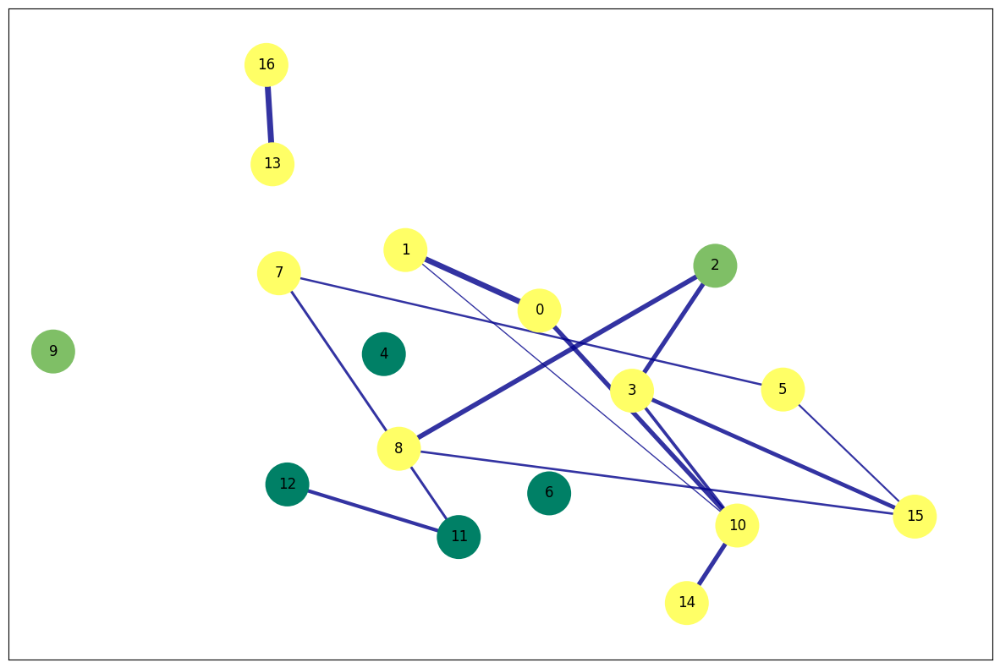

In [ ]:
G, G_complete=plot_network(p, 0.3, same_posicion_data, df_info)

# Acoustic heterogeneity identification analysis

# Total variation distance of probability measures

In probability theory, the total variation distance is a distance measure for probability distributions. It is an example of a statistical distance metric, and is sometimes called the statistical distance, statistical difference or variational distance.


In [ ]:
df2

,2,3,4,5,6,7,8,9,10,11,...,346,348,349,351,352,353,354,355,356,358
0,2147,5991,965,2070,13,11267,2588,13203,370,372,...,178,68,38,25,51,33,2,1,1,17
1,1733,4502,637,2110,50,2307,1232,5179,91,65,...,140,99,37,54,129,43,0,0,1,21
2,640,5983,704,6192,0,13213,151,6781,900,54,...,143,191,20,46,16,34,1,1,0,21
3,450,6319,359,4335,0,10314,516,9410,627,289,...,181,147,42,39,80,33,1,1,3,32
4,391,9177,468,1416,0,2120,846,1809,213,1538,...,214,284,38,112,49,135,1,1,2,64
5,751,7728,330,675,2,12486,401,5930,1261,2072,...,80,245,32,153,64,48,5,4,2,41
6,776,12360,1500,1604,5,15887,692,8396,1237,2925,...,168,121,19,96,123,38,11,0,2,37
7,535,8602,490,543,1,5782,634,4752,760,1133,...,192,102,30,95,114,87,8,0,1,29
8,698,4911,252,2953,14,9522,647,6002,234,1487,...,307,176,26,66,77,87,0,1,0,24
9,52,4394,88,6,0,2430,8,513,68,0,...,212,93,4,50,80,23,0,0,3,18


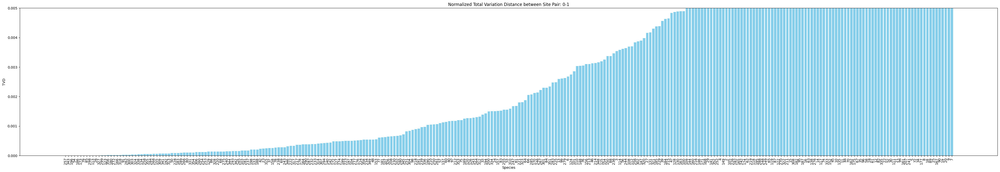

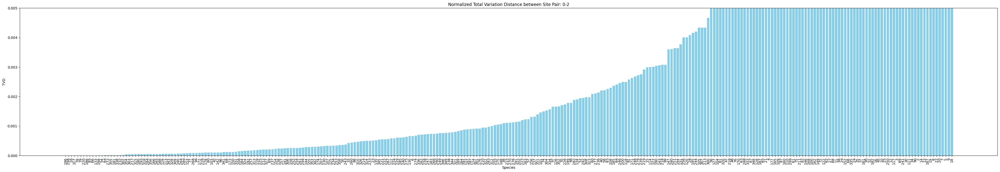

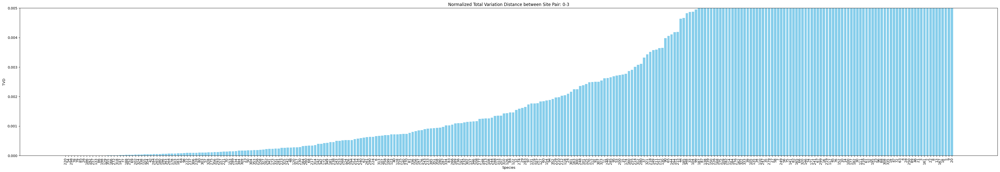

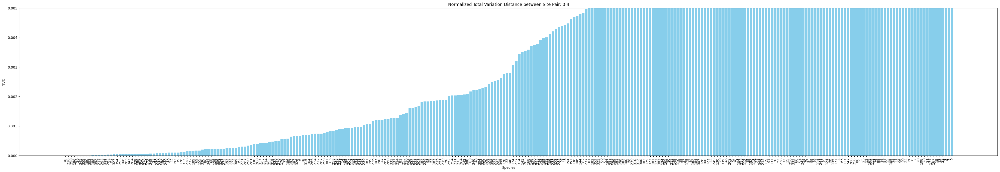

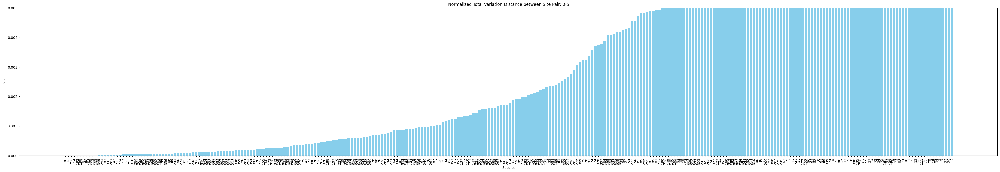

...

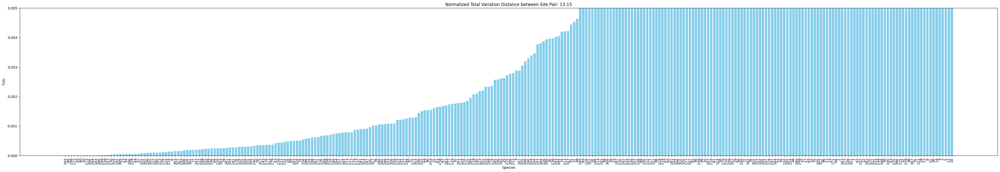

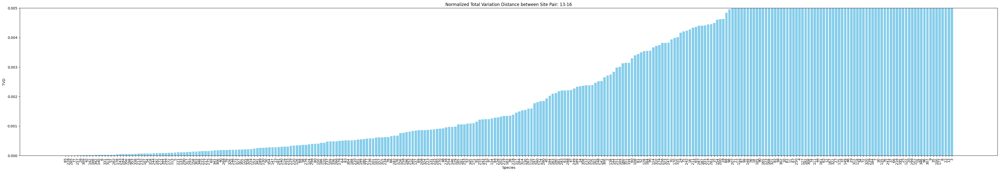

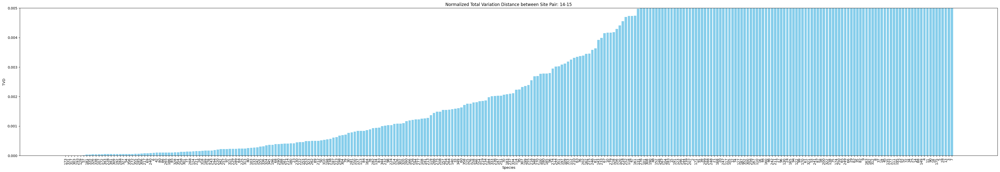

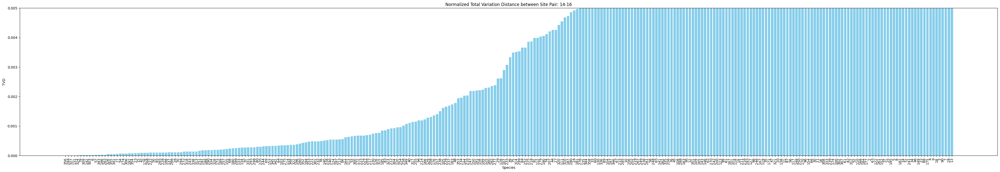

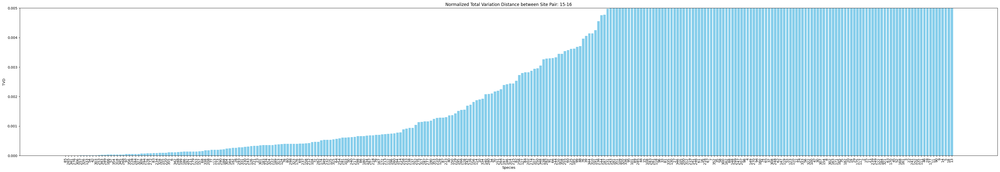

In [ ]:
num_sites = df2.shape[0]
species_names = df2.columns

site_combinations = [f'{i}-{j}' for i, j in combinations(range(num_sites), 2)]

# Calculate distances for each species in all combinations of sites
distances = {}
for species in species_names:
    species_distances = []
    for site1, site2 in combinations(range(num_sites), 2):
        # Obtain counts for each site
        count1, count2 = df2[species].iloc[site1], df2[species].iloc[site2]

        #  Calculate relative frequencies
        total_count1 = df2.iloc[site1].sum()
        total_count2 = df2.iloc[site2].sum()
        freq1 = count1 / total_count1 if total_count1 != 0 else 0
        freq2 = count2 / total_count2 if total_count2 != 0 else 0

        # Calculate the total variation distance for this species between the two sites.
        distance = 0.5*np.abs(freq1 - freq2)  # TVD

        species_distances.append(distance)
    distances[species] = species_distances

distances_df = pd.DataFrame(distances, index=site_combinations)

min_val = distances_df.values.min()
max_val = distances_df.values.max()
normalized_distances_df = (distances_df - min_val) / (max_val - min_val)

# plot for each pair of sites
for i in range(len(site_combinations)):
    fig, ax = plt.subplots(figsize=(40, 7))

    normalized_diff = normalized_distances_df.iloc[i, :]
    sorted_indices = normalized_diff.argsort()
    sorted_diff = normalized_diff.iloc[sorted_indices]

    species_labels = [species_names[j] for j in sorted_indices]
    x_positions = np.arange(len(species_names))

    ax.bar(x_positions, sorted_diff, color='skyblue')

    ax.set_xticks(x_positions)
    ax.set_xticklabels(species_labels, rotation=90)

    ax.set_title(f'Normalized Total Variation Distance between Site Pair: {site_combinations[i]}')
    ax.set_xlabel('Species')
    ax.set_ylabel('TVD')
    ax.set_ylim(0, 0.005)


    plt.tight_layout()
    plt.show()


Total Variation distance and selection of values calculating median - 0.02 standard deviations

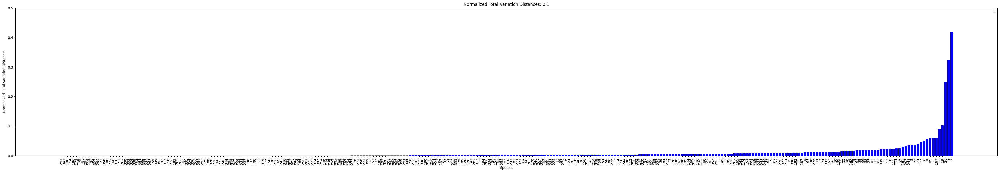

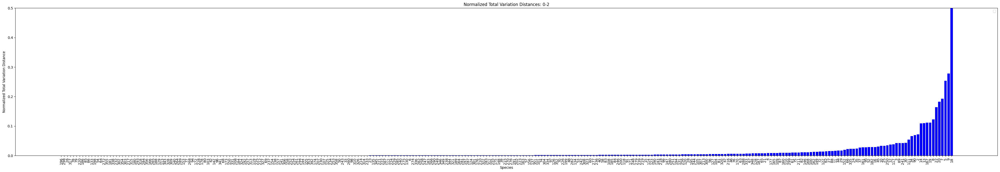

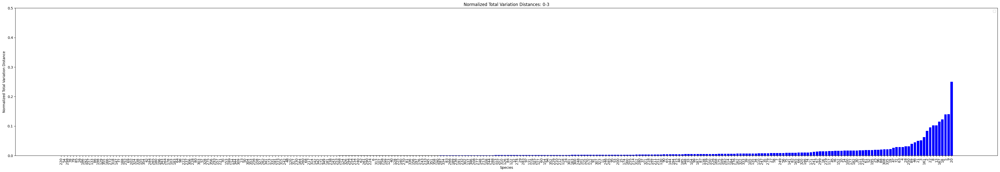

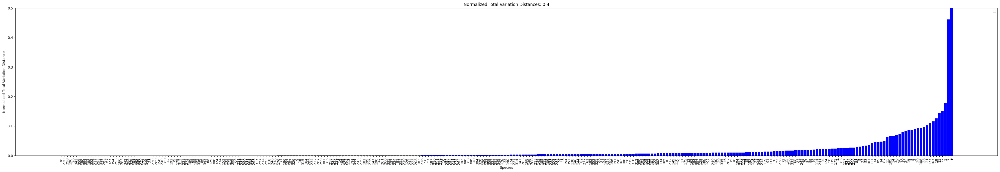

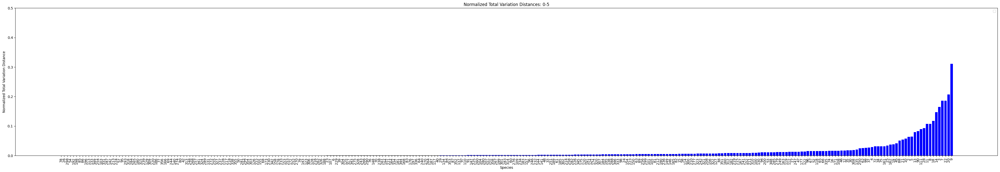

...

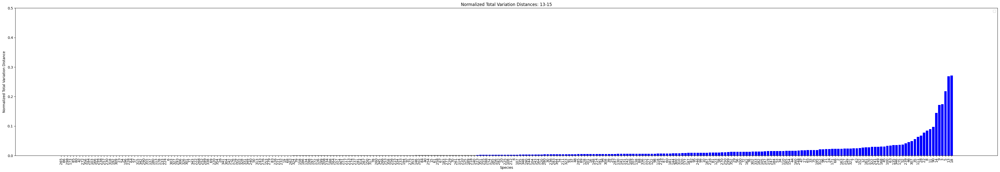

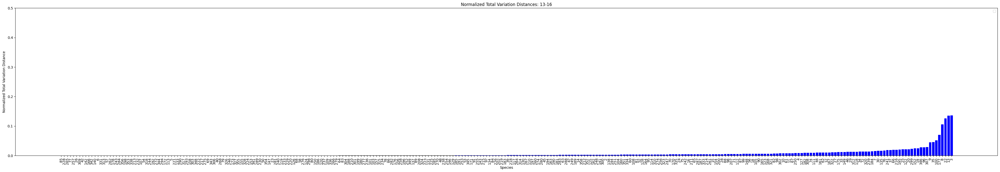

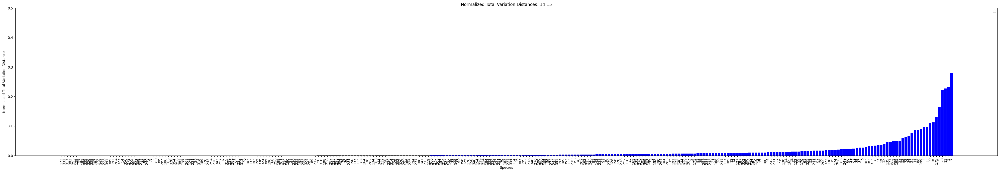

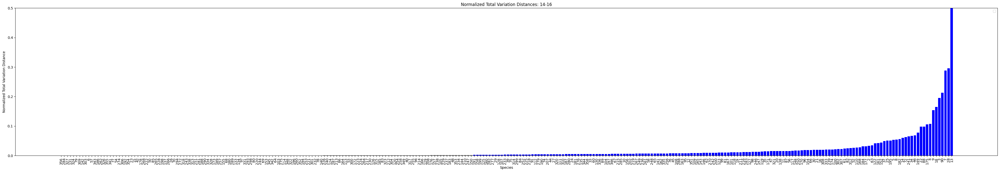

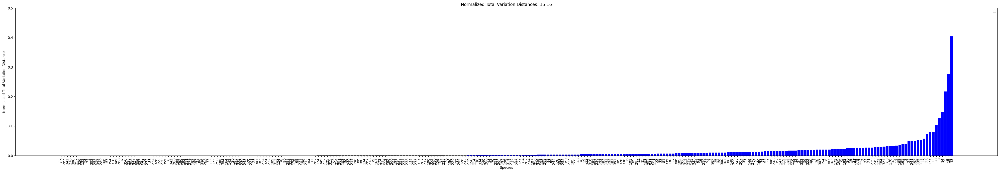

In [67]:
num_sites = df2.shape[0]
species_names = df2.columns

all_combinations_indices = list(combinations(range(num_sites), 2))

site_combinations = [f'{i}-{j}' for i, j in combinations(range(num_sites), 2)]
distances = {}
for species in species_names:
    species_distances = []
    for site1, site2 in combinations(range(num_sites), 2):
        count1, count2 = df2[species].iloc[site1], df2[species].iloc[site2]

        total_count1 = df2.iloc[site1].sum()
        total_count2 = df2.iloc[site2].sum()
        freq1 = count1 / total_count1 if total_count1 != 0 else 0
        freq2 = count2 / total_count2 if total_count2 != 0 else 0

        distance = 0.5 * np.abs(freq1 - freq2)

        species_distances.append(distance)
    distances[species] = species_distances


distances_df = pd.DataFrame(distances, index=site_combinations)

min_val = distances_df.values.min()
max_val = distances_df.values.max()
normalized_distances_df = (distances_df - min_val) / (max_val - min_val)

valores_por_par = {}
valores_diferentes = {}


for combination in site_combinations:
    fig, ax = plt.subplots(figsize=(40, 7))

    distances_row = normalized_distances_df.loc[combination, :]

    sorted_distances = distances_row.sort_values()

    median_val = np.median(sorted_distances)
    std_val = np.std(sorted_distances)
    value = 0.02
    threshold = median_val - (value*std_val)
    threshold_diferentes = 0.02

    selected_species = sorted_distances[sorted_distances < threshold].index.tolist()
    valores_por_par[combination] = selected_species

    selected_species_d = sorted_distances[sorted_distances > threshold_diferentes].index.tolist()
    valores_diferentes[combination] = selected_species_d


    colors = ['blue' if value > threshold else 'grey' for value in sorted_distances]

    ax.bar(range(len(sorted_distances)), sorted_distances, color=colors)
    ax.set_xticks(range(len(sorted_distances)))
    ax.set_xticklabels(sorted_distances.index, rotation=90)
    ax.set_title(f'Normalized Total Variation Distances: {combination}')
    ax.set_xlabel('Species')
    ax.set_ylabel('Normalized Total Variation Distance')
    ax.set_ylim(0, 0.5)
    ax.legend()

    plt.tight_layout()
    plt.show()

# Plot sonotypes for all pairs of sites in their respective time-frequency slot

In [ ]:
filtered_df #ya dataframe tiene el identificador numerico del sitio

,File,Length,Fdom,FminVoc,FmaxVoc,Class,Membership,Bandwidth,Month,Day,Hour,Site
0,SMA03126,0.789333,6210.846037,6117.1875,7617.1875,35,0.828466,1500.0000,3,22,15,13
1,SMA03126,0.085333,5624.954268,5578.1250,6140.6250,230,0.813142,562.5000,3,22,15,13
2,SMA03126,0.138667,5390.396341,5156.2500,5625.0000,226,0.800139,468.7500,3,22,15,13
3,SMA03126,0.576000,6421.783537,6328.1250,7617.1875,8,0.829095,1289.0625,3,22,15,13
4,SMA03126,0.085333,5928.452744,4664.0625,6375.0000,277,0.803985,1710.9375,3,22,15,13
...,...,...,...,...,...,...,...,...,...,...,...,...
803855,SMA03406,0.416000,5202.233232,4289.0625,5437.5000,72,0.926167,1148.4375,3,27,16,11
803856,SMA03406,0.106667,2179.664634,2156.2500,2859.3750,13,0.960508,703.1250,3,27,16,11
803857,SMA03406,0.288000,4734.123476,4476.5625,4992.1875,175,0.967124,515.6250,3,27,16,11
803858,SMA03406,0.234667,4757.583841,4523.4375,4968.7500,135,0.954592,445.3125,3,27,16,11


Dash application to select and plot sonotypes

In [65]:
import dash
from dash import dcc, html, Input, Output, State
import plotly.express as px


app = dash.Dash(__name__)

app.layout = html.Div([
    dcc.Dropdown(
        id='site_pair_selector',
        options=[{'label': f'{pair[0]}-{pair[1]}', 'value': f'{pair[0]}-{pair[1]}'} for pair in all_combinations_indices],
        placeholder="Select a couple of sites"
    ),
    dcc.Checklist(
        id='class_selector',
        options =[],
        value=[],
        style={'display': 'grid', 'grid-template-columns': 'repeat(auto-fill, minmax(150px, 1fr))'}
    ),

    html.Button("Select/Unselect All", id="select_all_button", n_clicks=0),
    dcc.Graph(id='scatterPlot'),

])

@app.callback(
    Output('class_selector', 'options'),
    [Input('site_pair_selector', 'value')]
)
def update_class_checklist(selected_site_pair):
    if selected_site_pair:
        available_classes = valores_por_par.get(selected_site_pair, [])
        return [{'label': clase, 'value': clase} for clase in available_classes]
    return []

@app.callback(
    Output('class_selector', 'value'),
    [Input('select_all_button', 'n_clicks')],
    [State('class_selector', 'options'), State('class_selector', 'value')]
)

def select_deselect_all(n_clicks, options, values):
    if n_clicks % 2 == 1:
        return [option['value'] for option in options]
    else:
        return []

@app.callback(
    Output('scatterPlot', 'figure'),
    [Input('site_pair_selector', 'value'),
    Input('class_selector', 'value')]
)


def update_plot(selected_site_pair, selected_classes):

    if not selected_site_pair or not selected_classes:
        return px.scatter(title="Seleccione un par de sitios y al menos una clase")

    site1, site2 = selected_site_pair.split('-')

    site1 = int(site1)
    site2 = int(site2)

    df_to_plot = filtered_df[((filtered_df['Site'] == site1) | (filtered_df['Site'] == site2)) &
                              (filtered_df['Class'].isin(selected_classes))]

    if df_to_plot.empty:
        return px.scatter(title="No data available for the selected pair of sites and classes.")


    fig = px.scatter(df_to_plot,
                     x='Hour',
                     y='Fdom',
                     color='Class',
                     symbol='Class',
                     title=f'Sites {selected_site_pair}',
                     labels={'Hour': 'Time [Hour]', 'Fdom': 'Peak Frequency'},
                     color_continuous_scale=px.colors.sequential.Turbo
                     #color_continuous_scale=px.colors.diverging.delta

                    )

    fig.update_layout(
        legend=dict(
            title=dict(text='Sonotype'),
            font=dict(size=16),
            traceorder='normal'
        )
    )

    fig.update_xaxes(range=[0, 24])
    fig.update_yaxes(range=[0, 22000])

    fig.update_layout(coloraxis_showscale=False)


    return fig

if __name__ == '__main__':
    app.run_server(debug=True, port=8051)


<IPython.core.display.Javascript object>

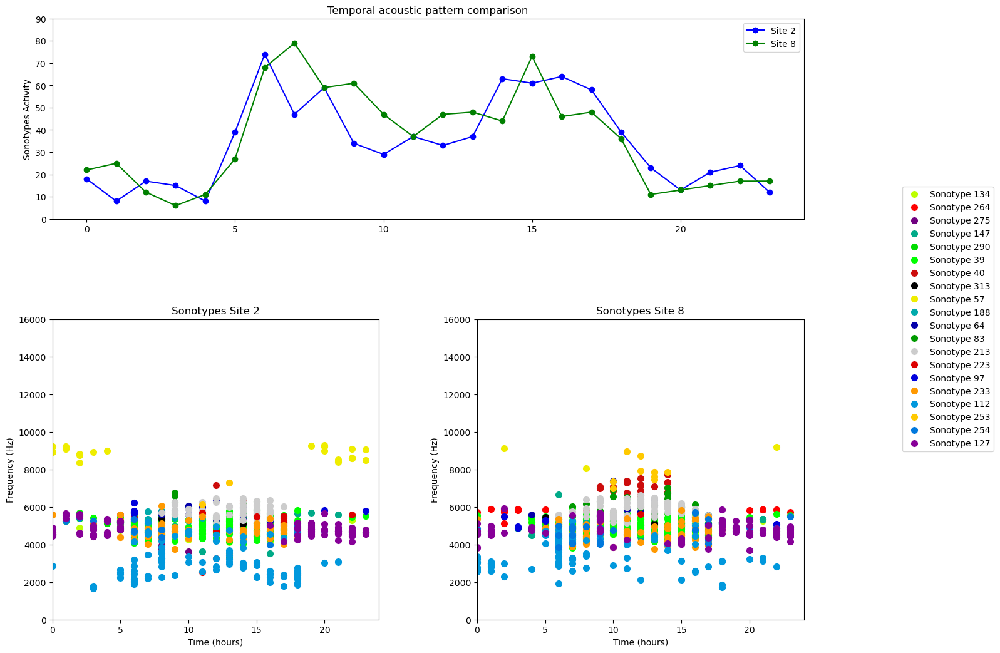

In [ ]:
# Example of plot using selected sonotypes
clases_en_azul = [313,275,127,64,97,254,112,188,147,83,137,290,39,134,57,253,233,264,223,40,213]
sites=[(2,8)]

def obtener_sonotipos_comunes_en_azul(site1, site2, df, sonotipos_especificos):
    sonotipos_sitio1 = set(df[(df['Site'] == site1) & (df['Class'].isin(sonotipos_especificos))]['Class'])
    sonotipos_sitio2 = set(df[(df['Site'] == site2) & (df['Class'].isin(sonotipos_especificos))]['Class'])
    return sonotipos_sitio1.intersection(sonotipos_sitio2)

colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, len(clases_en_azul)))
class_color_mapping = {clase: color for clase, color in zip(clases_en_azul, colors)}

fig = plt.figure(figsize=(15, 12))
gs = fig.add_gridspec(2, 2, height_ratios=[1, 1.5])

ax_temporal = fig.add_subplot(gs[0, :])
ax_sitio_1 = fig.add_subplot(gs[1, 0])
ax_sitio_2 = fig.add_subplot(gs[1, 1])

site1, site2 = sites[0]

sonotipos_comunes_en_azul = obtener_sonotipos_comunes_en_azul(site1, site2, filtered_df, clases_en_azul)

legend_handles = dict()

for site, color, label in [(site1, 'blue', f'Site {site1}'), (site2, 'green', f'Site {site2}')]:
    actividad_por_hora = filtered_df[(filtered_df['Site'] == site) & (filtered_df['Class'].isin(sonotipos_comunes_en_azul))].groupby('Hour').size()
    ax_temporal.plot(actividad_por_hora.index, actividad_por_hora.values, 'o-', color=color, label=label)

ax_temporal.set_title('Temporal acoustic pattern comparison')
ax_temporal.set_ylabel('Sonotypes Activity')
ax_temporal.set_ylim(0, 90)
ax_temporal.legend()

for site, ax_sitio in [(site1, ax_sitio_1), (site2, ax_sitio_2)]:
    for clase in sonotipos_comunes_en_azul:
        color = class_color_mapping.get(clase, 'grey')
        class_rows = filtered_df[(filtered_df['Class'] == clase) & (filtered_df['Site'] == site)]
        if not class_rows.empty:
            x = class_rows['Hour']
            y = class_rows['Fdom']
            marker = 'o'
            label = f'Sonotype {clase}'
            if clase not in legend_handles:
                handle = ax_sitio.plot(x, y, marker, linestyle='', color=color, markersize=7, label=label)[0]
                legend_handles[clase] = handle
            else:
                ax_sitio.plot(x, y, marker, linestyle='', color=color, markersize=7)

    ax_sitio.set_xlim(0, 24)
    ax_sitio.set_ylim(0, 16000)
    ax_sitio.set_xlabel('Time (hours)')
    ax_sitio.set_ylabel('Frequency (Hz)')
    ax_sitio.set_title(f'Sonotypes Site {site}')

plt.tight_layout(pad=3.0)
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.4, wspace=0.3)

handles, labels = ax_sitio_1.get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)

plt.show()
